<a href="https://colab.research.google.com/github/Mohd-Saifuddin22/SAR-image-to-Optical-image-Conversion/blob/main/SAR_to_Optical_Conversion_using_supervied_Cycle_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Libraries

In [28]:
import os
import pathlib
import time
import datetime
from matplotlib import pyplot as plt
from IPython import display
import tensorflow as tf
tf.__version__
import time
import matplotlib.pyplot as plt
from IPython.display import clear_output
import tensorflow as tf
import numpy as np
import zipfile
from tensorflow.keras.preprocessing.image import img_to_array, load_img

# GENERATOR

In [29]:
def encode(filters, size, apply_batchnorm = True):
  initializer = tf.random_normal_initializer(0, 0.02)
  result = tf.keras.Sequential()
  result.add(tf.keras.layers.Conv2D(filters, size, strides = 2, padding = 'same',
                                    kernel_initializer=initializer, use_bias=False))
  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())
  result.add(tf.keras.layers.LeakyReLU())
  return result

In [30]:
def decode(filters, size, apply_dropout = False):
  initializer = tf.random_normal_initializer(0, 0.02)
  result = tf.keras.Sequential()
  result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides = 2, padding = 'same',
                                             kernel_initializer=initializer, use_bias=False))
  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
    result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [31]:
def Generator():
  inputs = tf.keras.layers.Input(shape = [256, 256, 3])

  downsampling = [
      encode(64, 4, apply_batchnorm = False), # (batch_size, 128, 128, 64)
      encode(128, 4), # (batch_size, 64, 64, 128)
      encode(256, 4), # (batch_size, 32, 32, 256)
      encode(512, 4), # (batch_size, 16, 16, 512)
      encode(512, 4), # (batch_size, 8, 8, 512)
      encode(512, 4), # (batch_size, 4, 4, 512)
      encode(512, 4), # (batch_size, 2, 2, 512)
      encode(512, 4), # (batch_size, 1, 1, 512)
  ]

  upsampling = [
      decode(512, 4, apply_dropout=True), # (batch_size, 2, 2, 512)
      decode(512, 4, apply_dropout=True), # (batch_size, 4, 4, 512)
      decode(512, 4, apply_dropout=True), # (batch_size, 8, 8, 512)
      decode(512, 4), # (batch_size, 16, 16, 512)
      decode(256, 4), # (batch_size, 32, 32, 256)
      decode(128, 4), # (batch_size, 64, 64, 128)
      decode(64, 4), # (batch_size, 128, 128, 64)
  ]

  output_channels = 3
  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(output_channels, 4, strides=2, padding='same',
                                         kernel_initializer=initializer, activation='tanh') # (batch_size, 256, 256, 3)

  x = inputs
  skips = []
  for down in downsampling:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  for up, skip in zip(upsampling, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs = inputs, outputs = x)


# DISCRIMINATOR

In [32]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  original = tf.keras.layers.Input(shape = [256,256,3], name='original_img')
  transformed = tf.keras.layers.Input(shape=[256,256,3], name='transformed_img')
  x = tf.keras.layers.concatenate([original, transformed]) # (batch_size, 256, 256, channels * 2)

  down1 = encode(64, 4, False)(x) # (batch_size, 128, 128, 64)
  down2 = encode(128, 4)(down1) # (batch_size, 64, 64, 128)
  down3 = encode(256, 4)(down2) # (batch_size, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides = 1, kernel_initializer=initializer, use_bias=False)(zero_pad1) # (batch_size, 31, 31, 512)
  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)
  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)
  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (batch_size, 33, 33, 512)
  last = tf.keras.layers.Conv2D(1, 4, strides = 1, kernel_initializer=initializer)(zero_pad2) # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs = [original, transformed], outputs = last)

In [33]:
output_channels = 3
generator_g = Generator()
generator_f = Generator()
discriminator_x = Discriminator()
discriminator_y = Discriminator()

# LOSSES

In [34]:
lambda_cycle = 10    # Cycle consistency weight
lambda_mse = 100     # MSE loss weight
lambda_identity = 0.5  # Identity loss weight
epochs = 100
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# Loss functions
def generator_adversarial_loss(d_generated_output):
    return loss_object(tf.ones_like(d_generated_output), d_generated_output)

def discriminator_loss(real, generated):
    real_loss = loss_object(tf.ones_like(real), real)
    generated_loss = loss_object(tf.zeros_like(generated), generated)
    print(generated_loss+real_loss)
    return real_loss + generated_loss

def cycle_consistency_loss(real_image, cycled_image):
    return lambda_cycle * tf.reduce_mean(tf.abs(real_image - cycled_image))

def identity_loss(real_image, same_image):
    return lambda_identity * tf.reduce_mean(tf.abs(real_image - same_image))

def mse_loss(generated_image, target_image):
    return lambda_mse * tf.reduce_mean(tf.square(generated_image - target_image))

def generator_loss(d_generated_output, generated_image, target_image, cycled_image, identity_image=None):
    gan_loss = generator_adversarial_loss(d_generated_output)
    cycle_loss = cycle_consistency_loss(target_image, cycled_image)
    mse_supervised_loss = mse_loss(generated_image, target_image)
    id_loss = identity_loss(target_image, identity_image) if identity_image is not None else 0
    total_gen_loss = gan_loss + cycle_loss + mse_supervised_loss + id_loss
    return total_gen_loss, gan_loss, cycle_loss, mse_supervised_loss, id_loss

# OPTIMIZERS

In [35]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

# CHECK POINT

In [47]:
checkpoint_dir = '/content'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_g=generator_g,
                                 generator_f=generator_f,
                                 discriminator_x=discriminator_x,
                                 discriminator_y=discriminator_y,
                                 generator_g_optimizer=generator_g_optimizer,
                                 generator_f_optimizer=generator_f_optimizer,
                                 discriminator_x_optimizer=discriminator_x_optimizer,
                                 discriminator_y_optimizer=discriminator_y_optimizer)

In [37]:
from google.colab import drive
drive.mount('/content')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# dataset

In [38]:
zip_path = '/content/drive/MyDrive/DATA SET.zip'
extract_path = '/content/data1'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

In [39]:
optical_dir = pathlib.Path(os.path.join(extract_path, 'optical'))
sar_dir = pathlib.Path(os.path.join(extract_path, 'sar'))

In [40]:
IMG_SIZE = 256
BATCH_SIZE = 72

In [41]:
import tensorflow as tf

def load_image(file_path):
    image = tf.io.read_file(file_path)
    image = tf.image.decode_png(image, channels=3)  # assuming 3 channels for RGB, adjust if different
    image = tf.image.convert_image_dtype(image, tf.float32)  # normalize image if needed
    return image

def load_data(optical_dir, sar_dir, batch_size=32):
    optical_images = []
    sar_images = []

    for i in range(1, 2001):
        optical_image = tf.data.Dataset.list_files(str(optical_dir / f'{i}.png')).map(load_image)
        sar_image = tf.data.Dataset.list_files(str(sar_dir / f'{i}.png')).map(load_image)
        optical_images.append(optical_image)
        sar_images.append(sar_image)

    optical_dataset = tf.data.Dataset.from_tensor_slices(optical_images).flat_map(lambda x: x)
    sar_dataset = tf.data.Dataset.from_tensor_slices(sar_images).flat_map(lambda x: x)

    return tf.data.Dataset.zip((optical_dataset, sar_dataset)).batch(batch_size)


In [42]:
train_dataset = load_data(optical_dir, sar_dir)

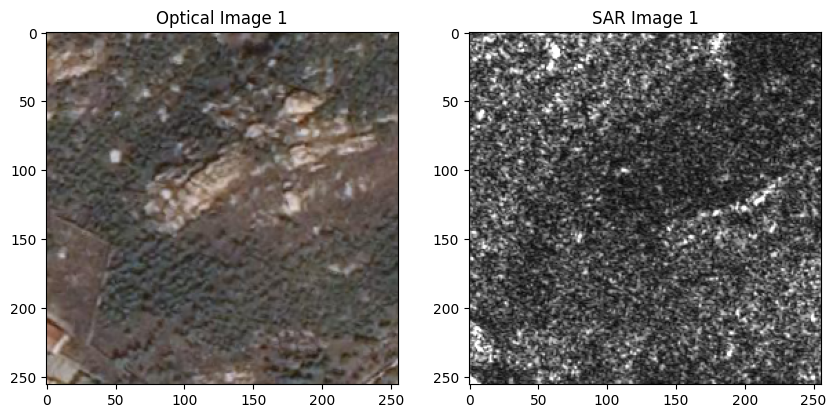

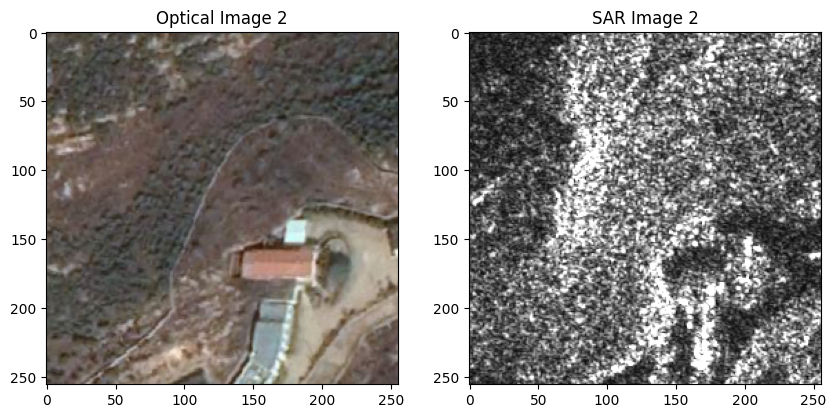

In [ ]:
import matplotlib.pyplot as plt

# Assuming 'train_dataset' is your loaded dataset
# Iterate through the dataset and display the first 4 image pairs
for optical_batch, sar_batch in train_dataset.take(1):  # Take only the first batch
    for i in range(min(15, optical_batch.shape[0])):  # Iterate through the first 4 images in the batch
        plt.figure(figsize=(10, 5))

        plt.subplot(1, 2, 1)
        plt.imshow(optical_batch[i])
        plt.title(f"Optical Image {i+1}")

        plt.subplot(1, 2, 2)
        plt.imshow(sar_batch[i])
        plt.title(f"SAR Image {i+1}")

        plt.show()

# TRAINING

In [44]:
@tf.function
def train_step(optical_image, sar_image):
    with tf.GradientTape(persistent=True) as tape:
        # Generator forward pass
        fake_sar = generator_g(optical_image, training=True)
        cycled_optical = generator_f(fake_sar, training=True)

        fake_optical = generator_f(sar_image, training=True)
        cycled_sar = generator_g(fake_optical, training=True)

        # Identity mappings
        same_optical = generator_f(optical_image, training=True)
        same_sar = generator_g(sar_image, training=True)

        # Discriminator output
        disc_real_optical = discriminator_x([optical_image, sar_image], training=True)
        disc_fake_optical = discriminator_x([optical_image, fake_optical], training=True)

        disc_real_sar = discriminator_y([sar_image, optical_image], training=True)
        disc_fake_sar = discriminator_y([sar_image, fake_sar], training=True)

        # Generator loss
        gen_g_loss, _, _, _, _ = generator_loss(disc_fake_sar, fake_sar, sar_image, cycled_sar, same_sar)
        gen_f_loss, _, _, _, _ = generator_loss(disc_fake_optical, fake_optical, optical_image, cycled_optical, same_optical)

        # Discriminator loss
        disc_x_loss = discriminator_loss(disc_real_optical, disc_fake_optical)
        disc_y_loss = discriminator_loss(disc_real_sar, disc_fake_sar)

    # Apply gradients
    generator_g_gradients = tape.gradient(gen_g_loss, generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(gen_f_loss, generator_f.trainable_variables)

    discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)

    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))
    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))


In [45]:
def generate_images(model, test_input, target):
    prediction = model(test_input, training=False)
    plt.figure(figsize=(15, 15))

    display_list = [test_input[0], target[0], prediction[0]]
    title = ['Ground Truth', 'input Image', 'Predicted Image']

    for i in range(3):
        plt.subplot(1, 3, i + 1)
        plt.title(title[i])
        plt.imshow(display_list[i] * 0.5 + 0.5)  # De-normalize to [0,1]
        plt.axis('off')
    plt.show()


No checkpoint found. Starting training from scratch.
Epoch 1/20 completed in 0:00:29
Elapsed time: 0:00:29, Estimated remaining time: 0:09:18


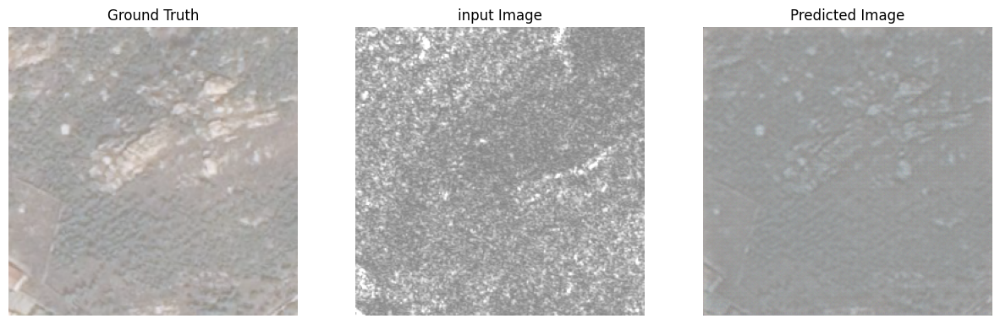

Epoch 2/20 completed in 0:00:29
Elapsed time: 0:00:58, Estimated remaining time: 0:08:44


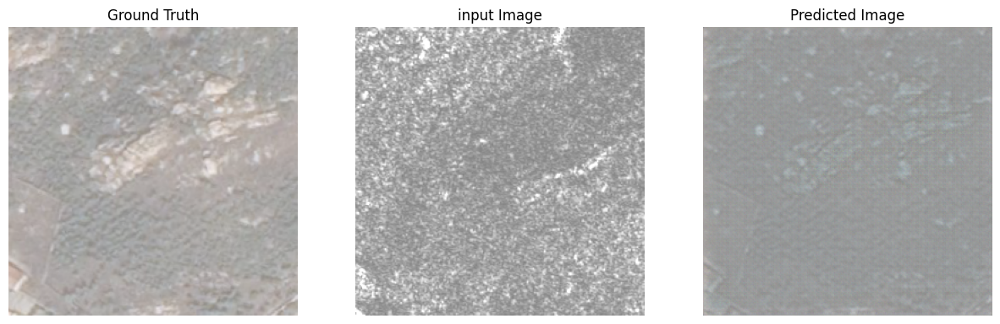

Epoch 3/20 completed in 0:00:28
Elapsed time: 0:01:26, Estimated remaining time: 0:08:12


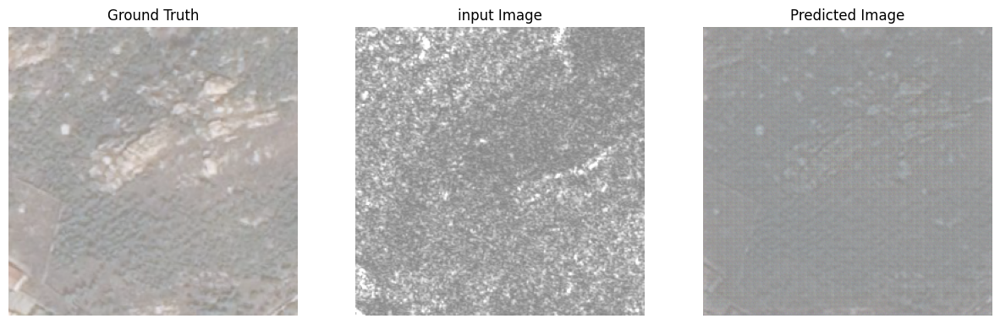

Epoch 4/20 completed in 0:00:29
Elapsed time: 0:01:58, Estimated remaining time: 0:07:52


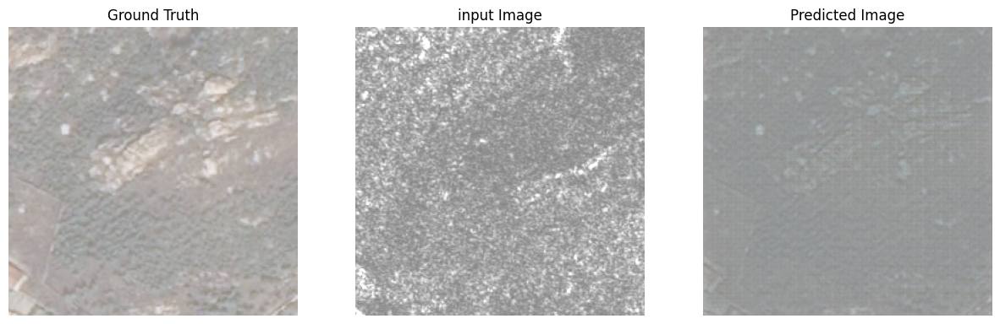

Epoch 5/20 completed in 0:00:30
Elapsed time: 0:02:34, Estimated remaining time: 0:07:44


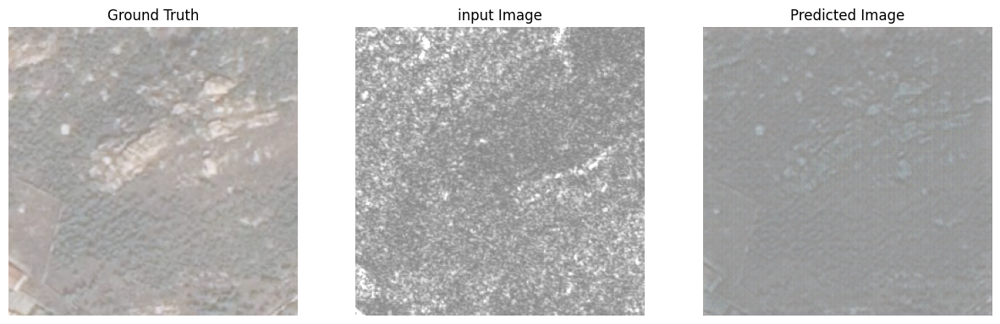

Epoch 6/20 completed in 0:00:30
Elapsed time: 0:03:01, Estimated remaining time: 0:07:04


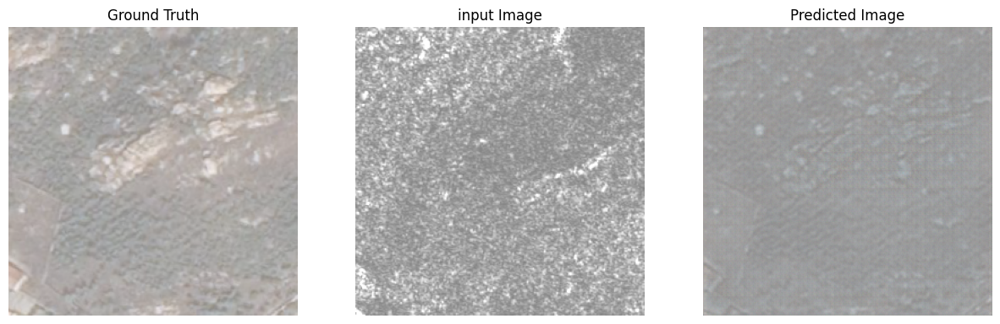

Epoch 7/20 completed in 0:00:30
Elapsed time: 0:03:33, Estimated remaining time: 0:06:37


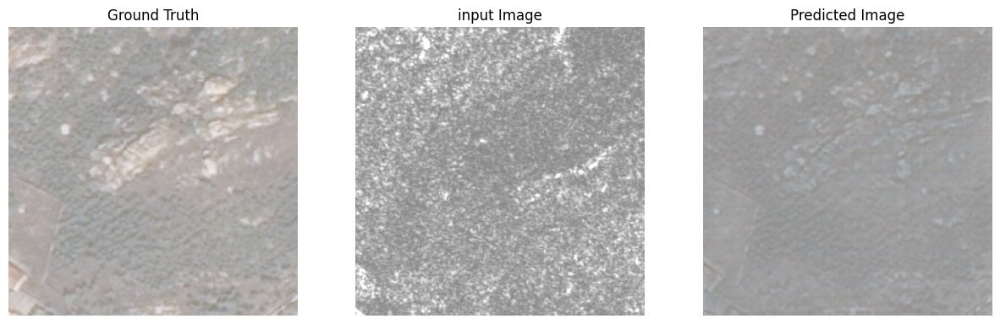

Epoch 8/20 completed in 0:00:29
Elapsed time: 0:03:58, Estimated remaining time: 0:05:57


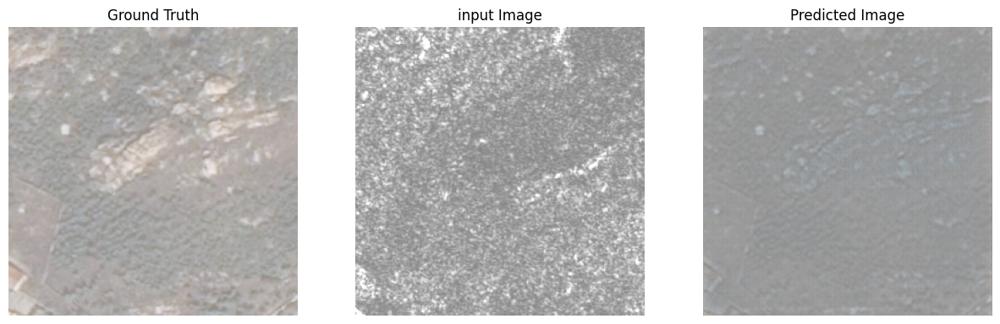

Epoch 9/20 completed in 0:00:29
Elapsed time: 0:04:25, Estimated remaining time: 0:05:24


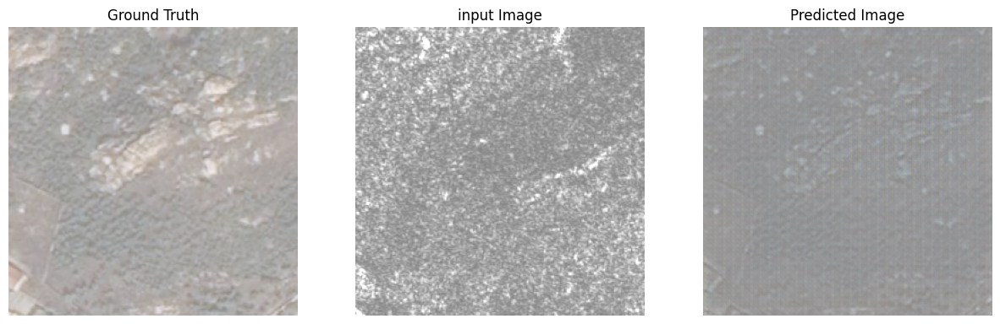

Epoch 10/20 completed in 0:00:29
Elapsed time: 0:04:57, Estimated remaining time: 0:04:57


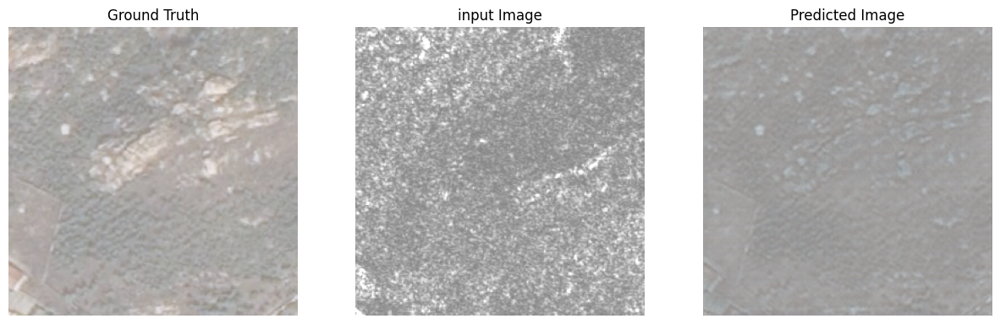

Epoch 11/20 completed in 0:00:29
Elapsed time: 0:05:26, Estimated remaining time: 0:04:26


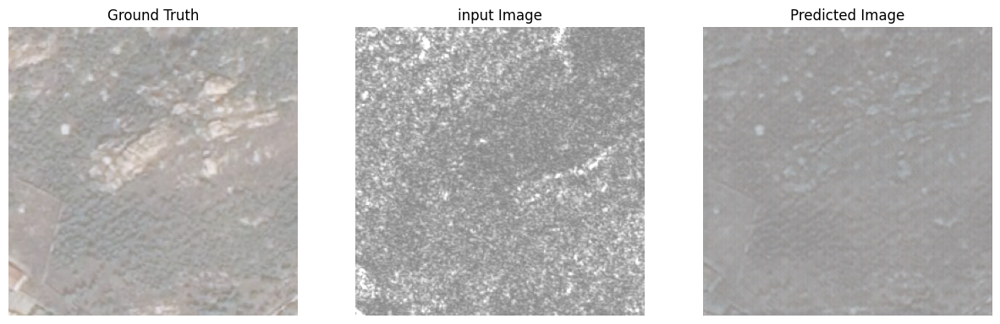

Epoch 12/20 completed in 0:00:27
Elapsed time: 0:05:31, Estimated remaining time: 0:03:40


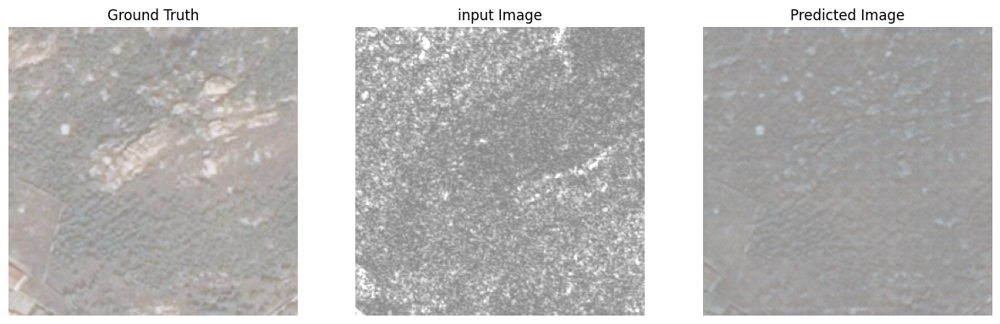

Epoch 13/20 completed in 0:00:30
Elapsed time: 0:06:30, Estimated remaining time: 0:03:30


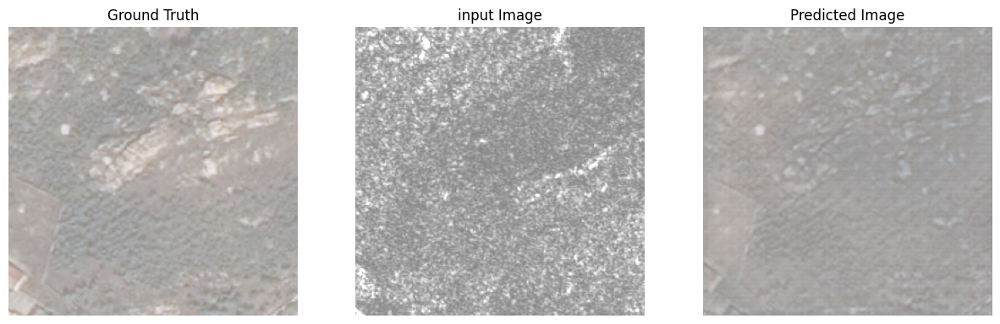

Epoch 14/20 completed in 0:00:30
Elapsed time: 0:07:01, Estimated remaining time: 0:03:00


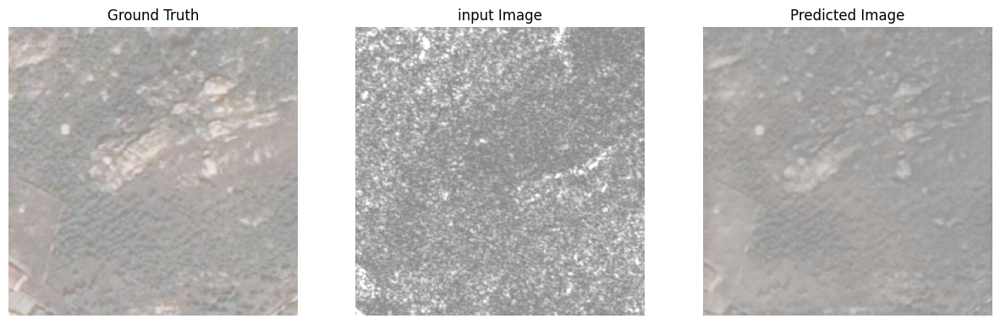

Epoch 15/20 completed in 0:00:29
Elapsed time: 0:07:29, Estimated remaining time: 0:02:29


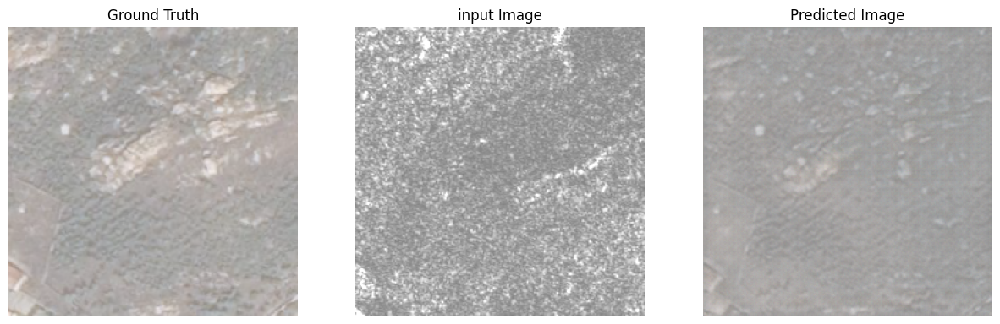

Epoch 16/20 completed in 0:00:30
Elapsed time: 0:08:03, Estimated remaining time: 0:02:00


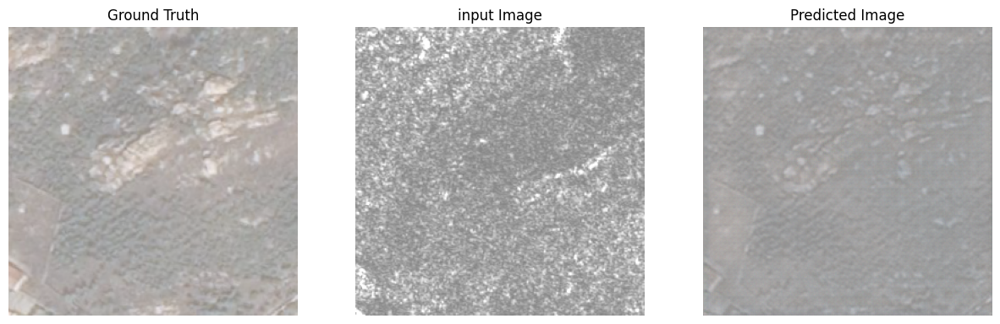

Epoch 17/20 completed in 0:00:30
Elapsed time: 0:08:30, Estimated remaining time: 0:01:30


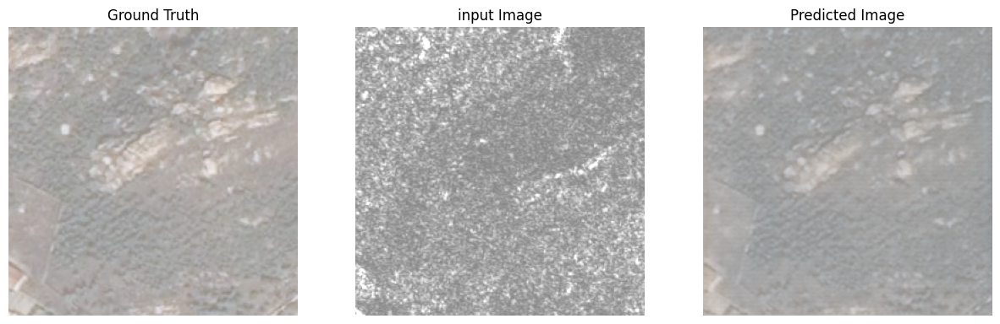

Epoch 18/20 completed in 0:00:30
Elapsed time: 0:09:17, Estimated remaining time: 0:01:01


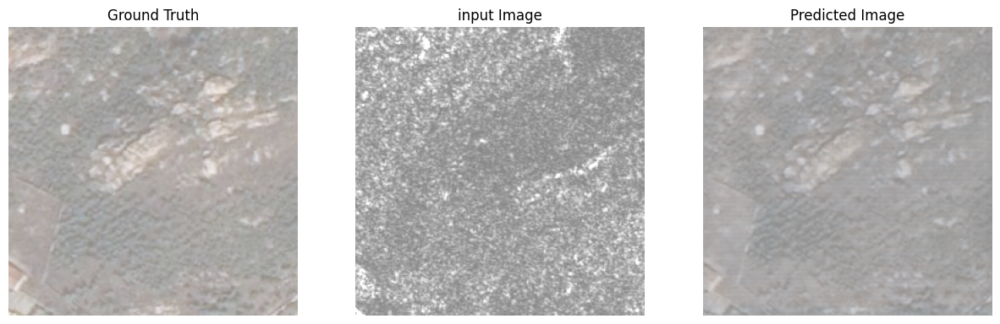

Epoch 19/20 completed in 0:00:31
Elapsed time: 0:09:51, Estimated remaining time: 0:00:31


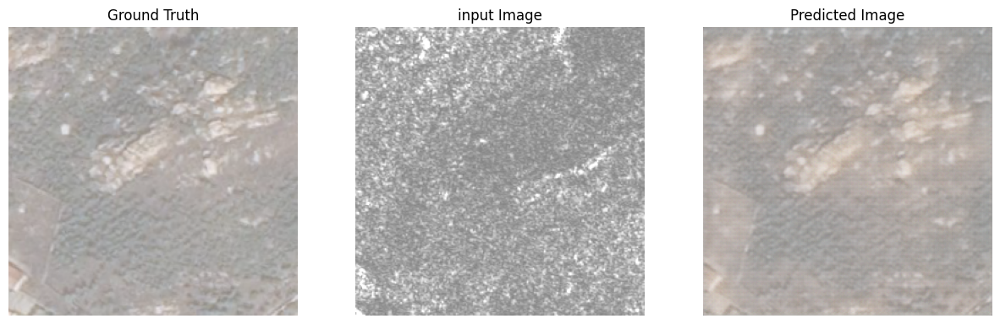

Epoch 20/20 completed in 0:00:29
Elapsed time: 0:09:49, Estimated remaining time: 0:00:00


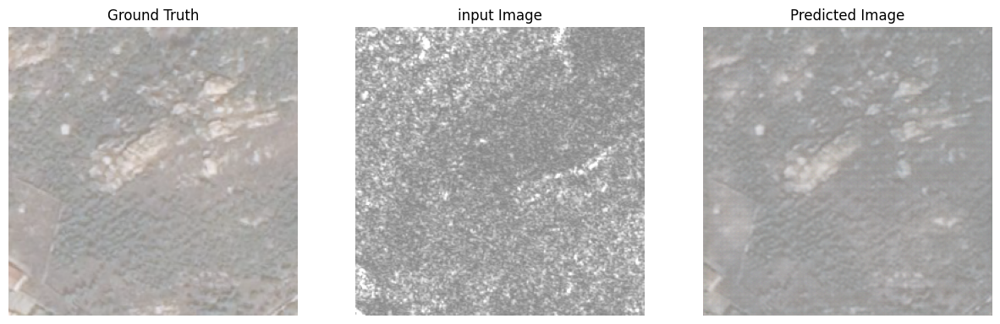

Training complete. Saving final checkpoint...
Checkpoint saved at /content


In [48]:
import time
from datetime import timedelta
# Check for existing checkpoints
if tf.train.latest_checkpoint(checkpoint_dir):
    print("Checkpoint found! Resuming training...")
    checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
else:
    print("No checkpoint found. Starting training from scratch.")

# Set these parameters based on available resources
EPOCHS = 20  # Adjust based on training needs

# Training loop with timing display
for epoch in range(EPOCHS):
    start_time = time.time()  # Start time for the epoch

    # Iterate over each batch
    for optical_image, sar_image in train_dataset:
        train_step(optical_image, sar_image)

    # Calculate elapsed time for the epoch
    epoch_time = time.time() - start_time
    elapsed_time = timedelta(seconds=int(epoch_time * (epoch + 1)))
    remaining_time = timedelta(seconds=int(epoch_time * (EPOCHS - (epoch + 1))))

    print(f"Epoch {epoch + 1}/{EPOCHS} completed in {str(timedelta(seconds=int(epoch_time)))}")
    print(f"Elapsed time: {elapsed_time}, Estimated remaining time: {remaining_time}")

    # Display sample results at the end of each epoch
    for optical_image, sar_image in train_dataset.take(1):
        generate_images(generator_g, optical_image, sar_image)

# Save checkpoint after training is complete
print("Training complete. Saving final checkpoint...")
checkpoint.save(file_prefix=checkpoint_prefix)
print(f"Checkpoint saved at {checkpoint_dir}")

Checkpoint found! Resuming training...
Epoch 1/20 completed in 0:00:29
Elapsed time: 0:00:29, Estimated remaining time: 0:09:12


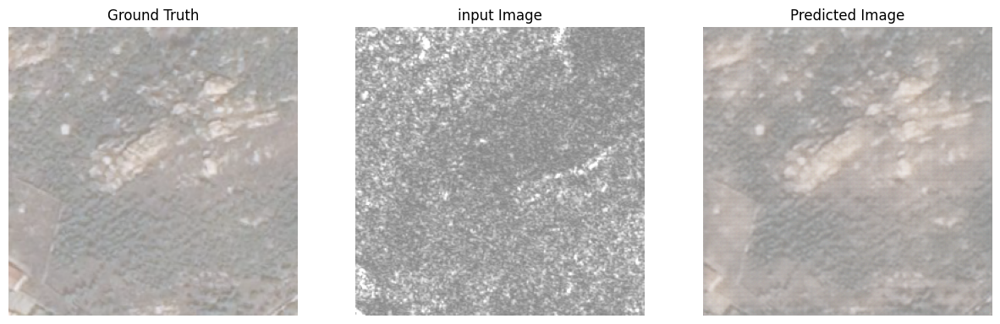

Epoch 2/20 completed in 0:00:28
Elapsed time: 0:00:57, Estimated remaining time: 0:08:38


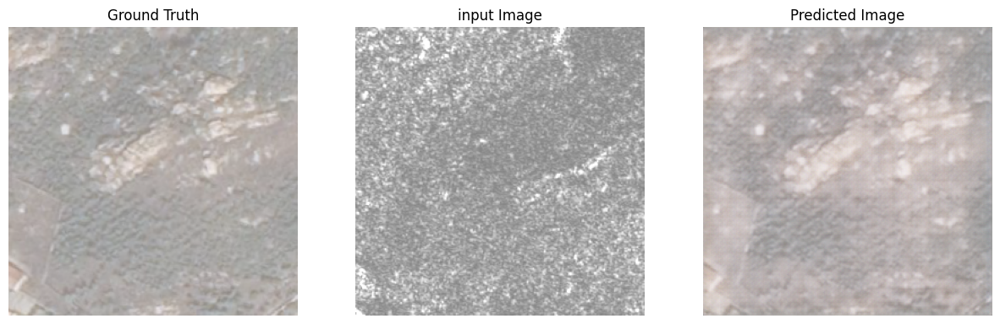

Epoch 3/20 completed in 0:00:28
Elapsed time: 0:01:25, Estimated remaining time: 0:08:06


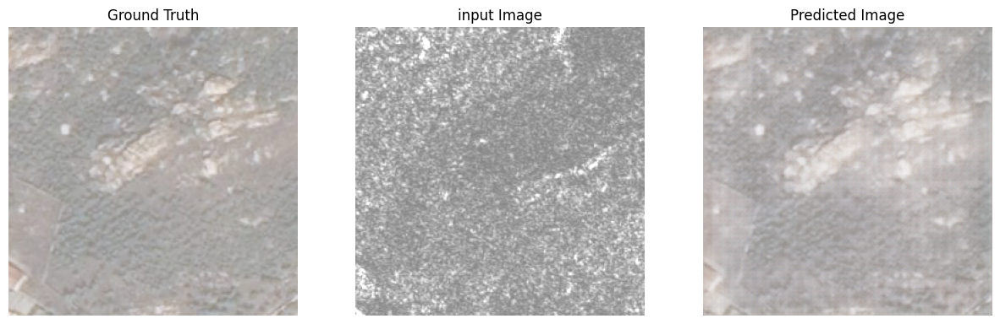

Epoch 4/20 completed in 0:00:28
Elapsed time: 0:01:55, Estimated remaining time: 0:07:41


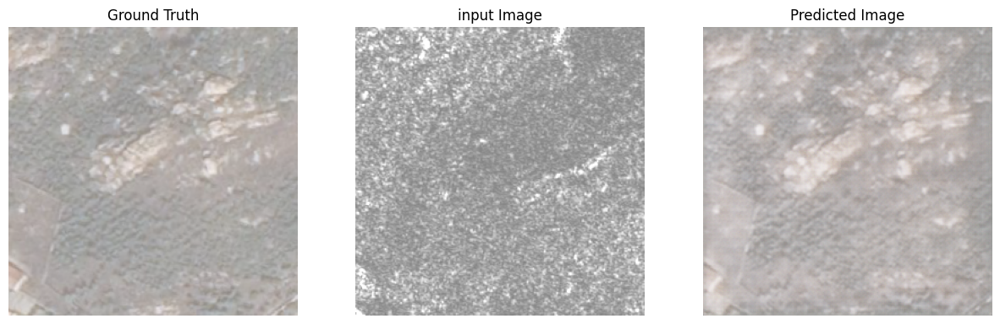

Epoch 5/20 completed in 0:00:28
Elapsed time: 0:02:23, Estimated remaining time: 0:07:09


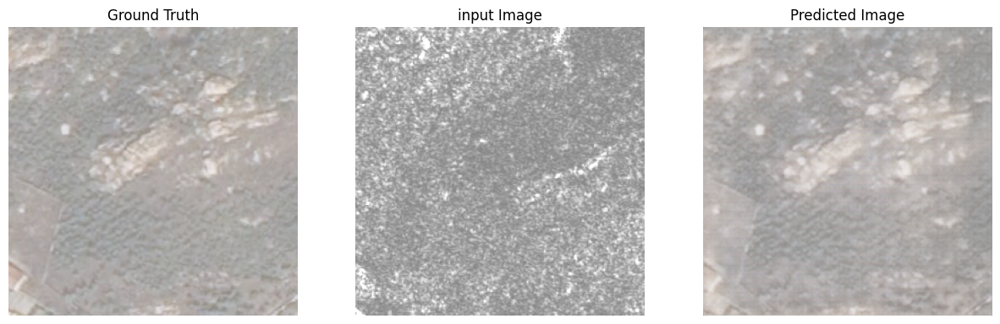

Epoch 6/20 completed in 0:00:28
Elapsed time: 0:02:51, Estimated remaining time: 0:06:40


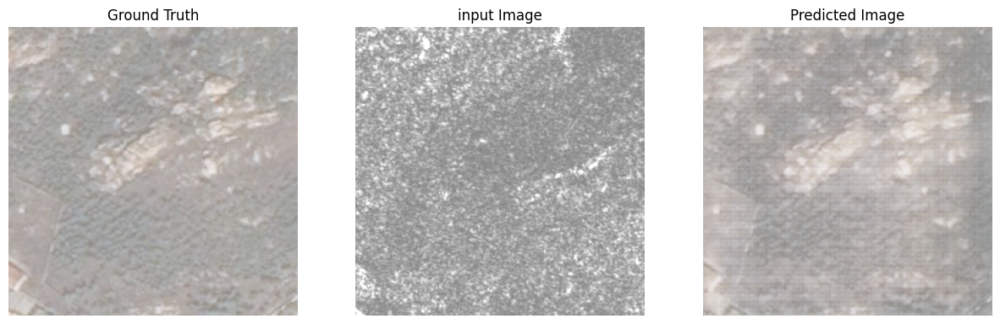

Epoch 7/20 completed in 0:00:28
Elapsed time: 0:03:20, Estimated remaining time: 0:06:12


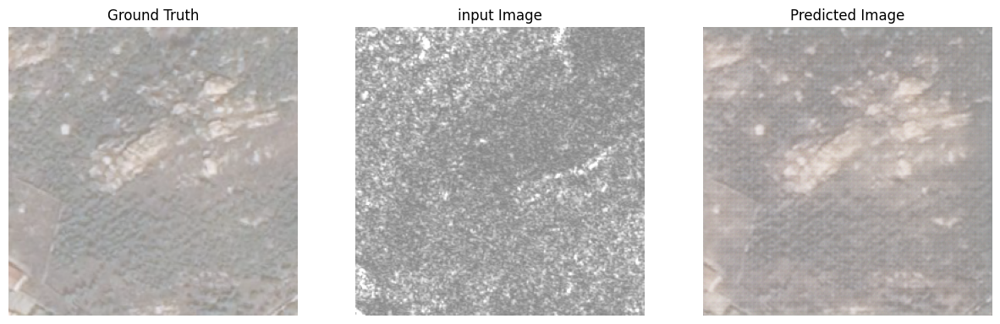

Epoch 8/20 completed in 0:00:28
Elapsed time: 0:03:50, Estimated remaining time: 0:05:45


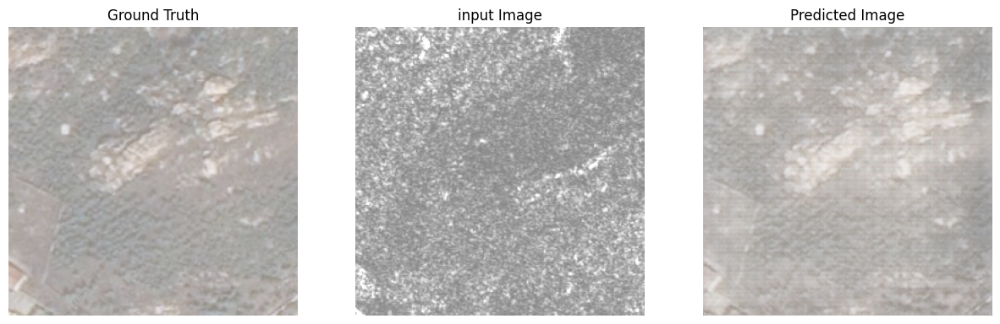

Epoch 9/20 completed in 0:00:28
Elapsed time: 0:04:19, Estimated remaining time: 0:05:17


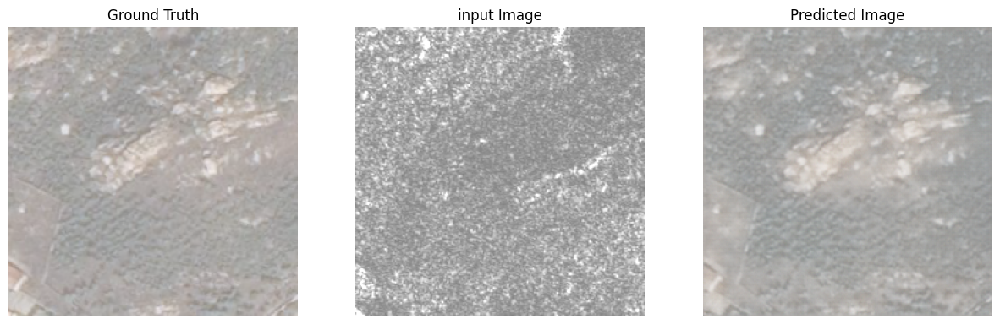

Epoch 10/20 completed in 0:00:28
Elapsed time: 0:04:49, Estimated remaining time: 0:04:49


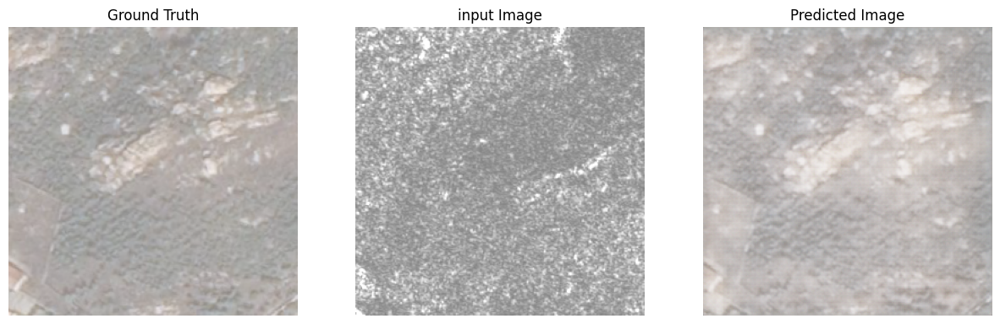

Epoch 11/20 completed in 0:00:28
Elapsed time: 0:05:13, Estimated remaining time: 0:04:16


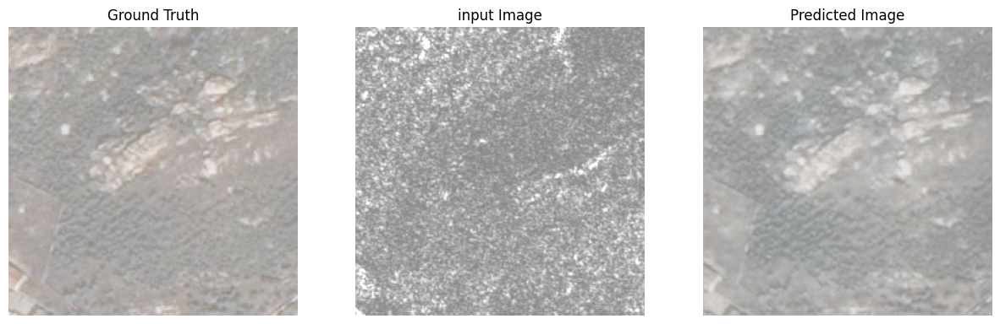

Epoch 12/20 completed in 0:00:28
Elapsed time: 0:05:42, Estimated remaining time: 0:03:48


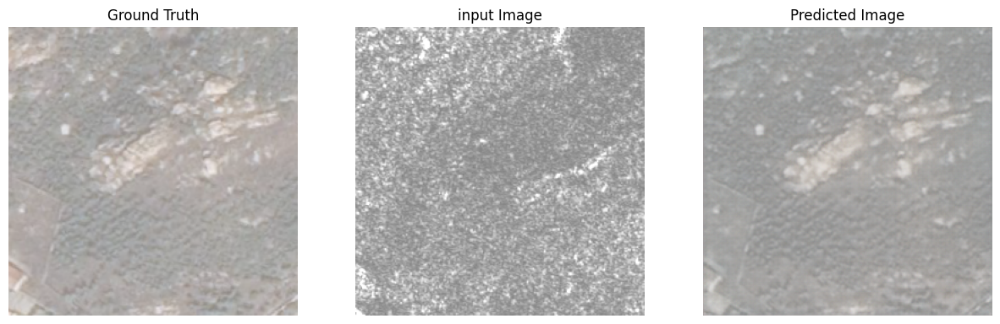

Epoch 13/20 completed in 0:00:28
Elapsed time: 0:06:10, Estimated remaining time: 0:03:19


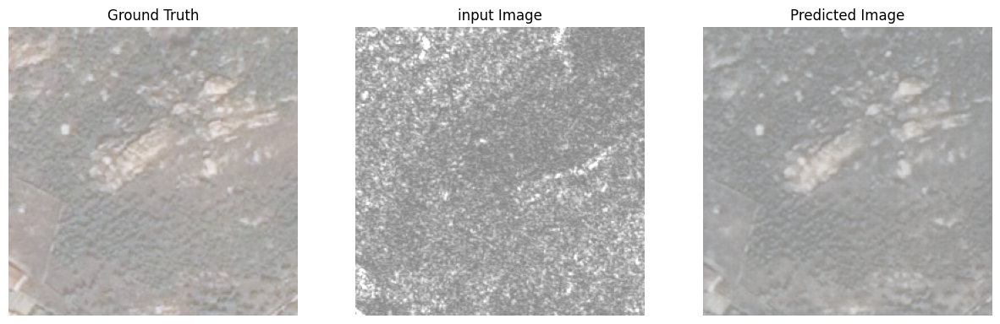

Epoch 14/20 completed in 0:00:28
Elapsed time: 0:06:36, Estimated remaining time: 0:02:50


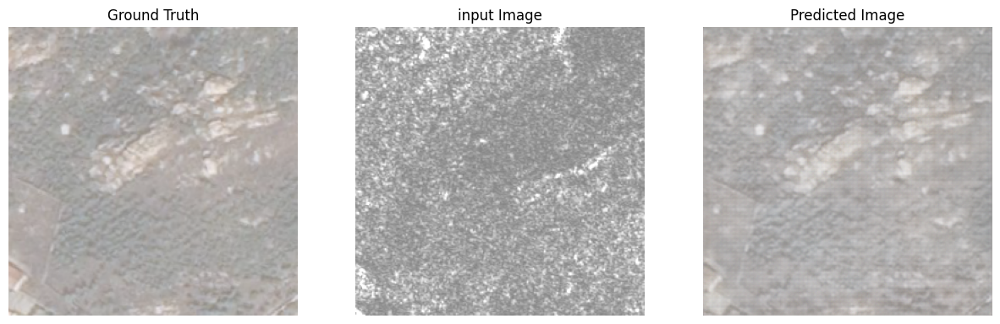

Epoch 15/20 completed in 0:00:28
Elapsed time: 0:07:08, Estimated remaining time: 0:02:22


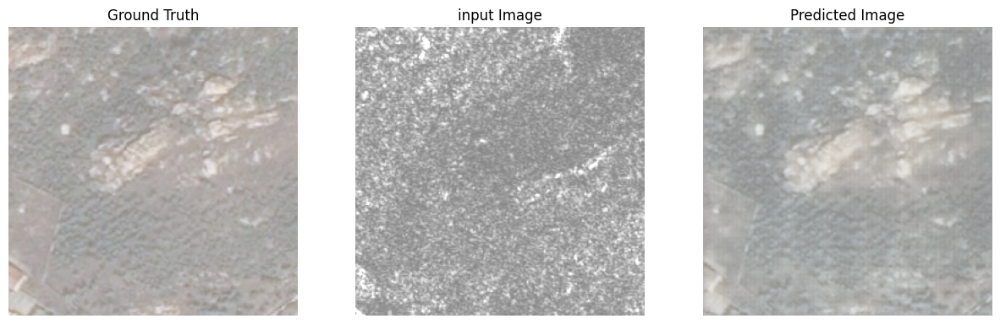

Epoch 16/20 completed in 0:00:28
Elapsed time: 0:07:37, Estimated remaining time: 0:01:54


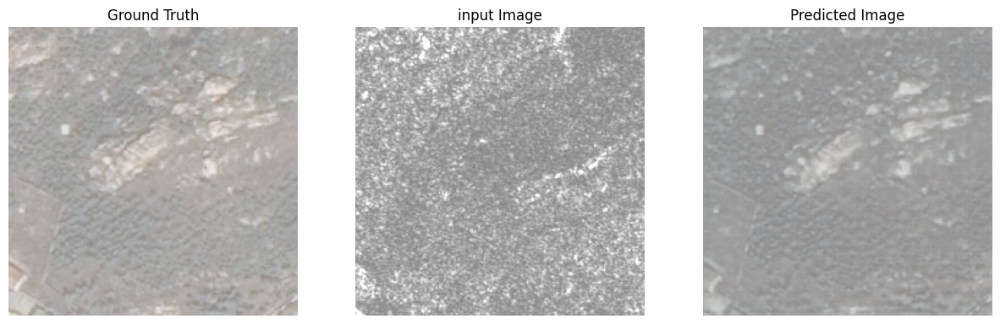

Epoch 17/20 completed in 0:00:28
Elapsed time: 0:08:04, Estimated remaining time: 0:01:25


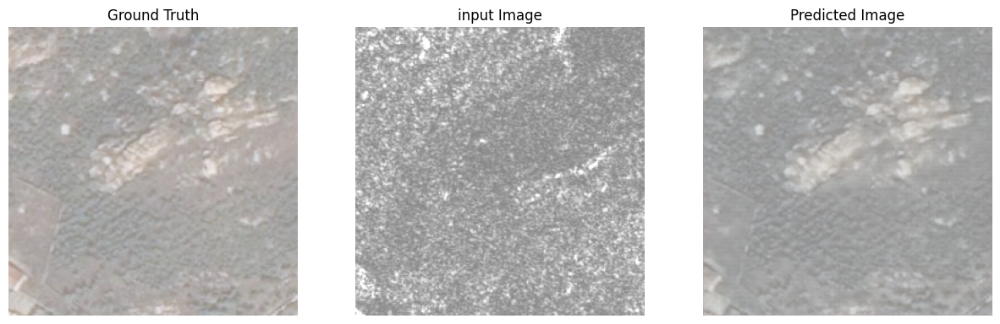

Epoch 18/20 completed in 0:00:28
Elapsed time: 0:08:34, Estimated remaining time: 0:00:57


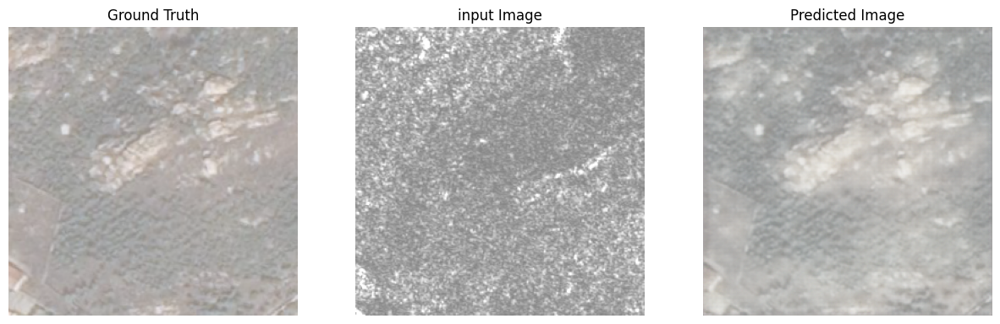

Epoch 19/20 completed in 0:00:28
Elapsed time: 0:09:03, Estimated remaining time: 0:00:28


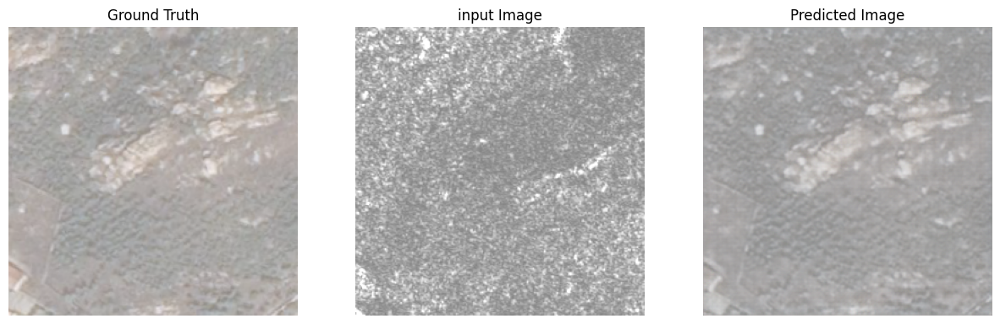

Epoch 20/20 completed in 0:00:28
Elapsed time: 0:09:33, Estimated remaining time: 0:00:00


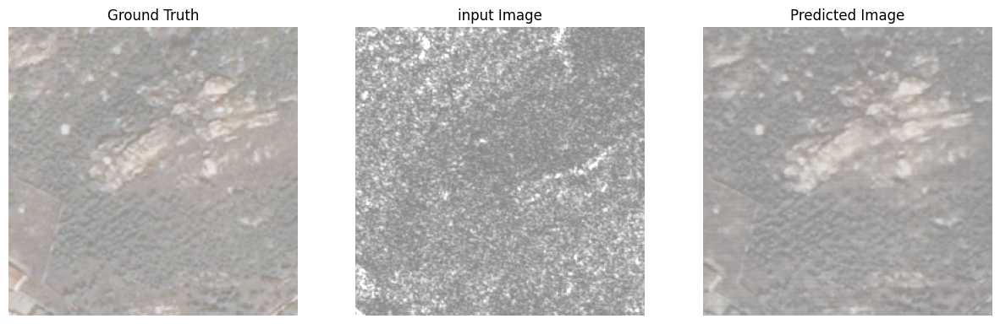

Training complete. Saving final checkpoint...
Checkpoint saved at /content


In [49]:
import time
from datetime import timedelta
# Check for existing checkpoints
if tf.train.latest_checkpoint(checkpoint_dir):
    print("Checkpoint found! Resuming training...")
    checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
else:
    print("No checkpoint found. Starting training from scratch.")

# Set these parameters based on available resources
EPOCHS = 20  # Adjust based on training needs

# Training loop with timing display
for epoch in range(EPOCHS):
    start_time = time.time()  # Start time for the epoch

    # Iterate over each batch
    for optical_image, sar_image in train_dataset:
        train_step(optical_image, sar_image)

    # Calculate elapsed time for the epoch
    epoch_time = time.time() - start_time
    elapsed_time = timedelta(seconds=int(epoch_time * (epoch + 1)))
    remaining_time = timedelta(seconds=int(epoch_time * (EPOCHS - (epoch + 1))))

    print(f"Epoch {epoch + 1}/{EPOCHS} completed in {str(timedelta(seconds=int(epoch_time)))}")
    print(f"Elapsed time: {elapsed_time}, Estimated remaining time: {remaining_time}")

    # Display sample results at the end of each epoch
    for optical_image, sar_image in train_dataset.take(1):
        generate_images(generator_g, optical_image, sar_image)

# Save checkpoint after training is complete
print("Training complete. Saving final checkpoint...")
checkpoint.save(file_prefix=checkpoint_prefix)
print(f"Checkpoint saved at {checkpoint_dir}")

In [51]:
import shutil
import os

# Define source and destination paths
source_files = [
    "/content/checkpoint",
    "/content/ckpt-1.data-00000-of-00001",
    "/content/ckpt-1.index",
    "/content/ckpt-2.data-00000-of-00001",
    "/content/ckpt-2.index"
]
destination_dir = "/content/drive/MyDrive/checkpoint (1)"

# Create the destination directory if it doesn't exist
os.makedirs(destination_dir, exist_ok=True)

# Move the files, overwriting if they exist
for file in source_files:
    if os.path.exists(file):
        # If the file already exists in the destination, remove it first
        destination_file = os.path.join(destination_dir, os.path.basename(file))
        if os.path.exists(destination_file):
            os.remove(destination_file)

        shutil.move(file, destination_dir) # Move the file